Here we recreate the sample visualisations seen in figure 1 (method overview) from the PBMC datasets.

In [1]:
import sys
sys.path.append('../src/')

import config
import logging
import numpy as np
import scanpy as sc
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt


from refcm import RefCM
from embeddings import HVGEmbedder, PCAEmbedder
from sklearn.metrics.pairwise import pairwise_distances


config.start_logging(logging.DEBUG)

In [2]:
# load the datasets
q = sc.read_h5ad('../data/pbmc_Drop-Seq.h5ad') 
ref = sc.read_h5ad('../data/pbmc_CEL-Seq.h5ad') 

[h5py._conv      ] [DEBUG   ] : Creating converter from 3 to 5


In [3]:
rcm = RefCM()
m = rcm.annotate(q, 'pbmc_Drop-Seq', ref, 'pbmc_CEL-Seq', 'labels', 'labels')

# evaluate, and display costs with results
m.display_matching_costs('labels', width=700, height=700, angle_x_labels=True)

[refcm           ] [INFO    ] : NOTE: raw counts expected in anndata .X attributes.
[refcm           ] [DEBUG   ] : Loading cached mapping costs from ../src/cache.json.
[refcm           ] [DEBUG   ] : Using costs for pbmc_Drop-Seq->pbmc_CEL-Seq found in cache.
[refcm           ] [DEBUG   ] : starting LP optimization
[refcm           ] [DEBUG   ] : optimization terminated w. status "Optimal"


For better data visualisation, we can plot the query and reference data, as well as their embeddings

         Falling back to preprocessing with `sc.pp.pca` and default params.


/opt/homebrew/anaconda3/envs/refcm/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html

... storing 'refcm_annot' as categorical
... storing 'query' as categorical
[matplotlib.pyplot] [DEBUG   ] : Loaded backend module://matplotlib_inline.backend_inline version unknown.
[matplotlib.pyplot] [DEBUG   ] : Loaded backend module://matplotlib_inline.backend_inline version unknown.
[matplotlib.font_manager] [DEBUG   ] : findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0.
[matplotlib.font_manager] [DEBUG   ] : findfont: score(FontEntry(fname='/opt/homebrew/anaconda3/envs/refcm/lib/python3.11/site-packages/matplotlib/mpl-data/fonts/ttf/STIXSizTwoSymReg.ttf', name='STIXSizeTwoSym', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
[matplotlib.font_manager] [DEBUG   ] : findfont: 

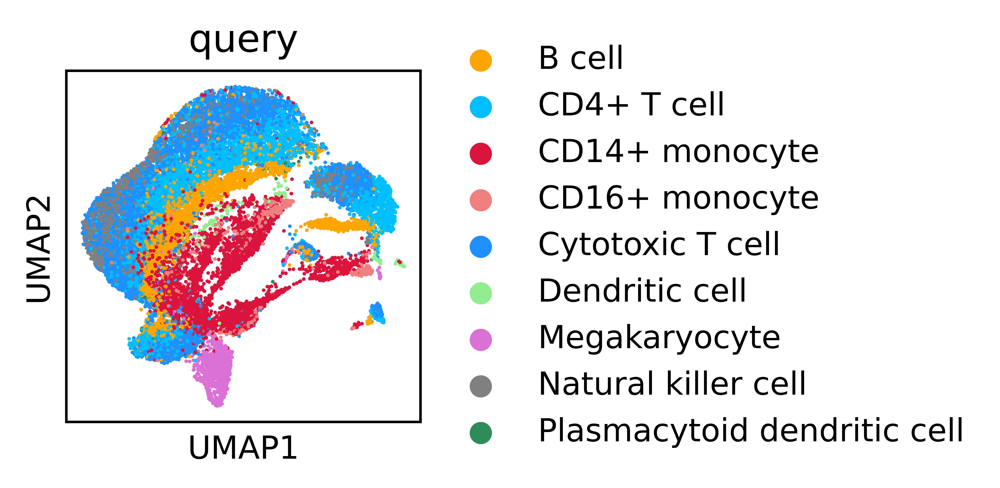

In [4]:
sc.pp.neighbors(q)
sc.tl.umap(q)

# rename labels for the plots 
q.obs['query'] = q.obs['labels'].astype('str')

palette = {"B cell": "orange", 
            "CD4+ T cell": "deepskyblue",
            "CD14+ monocyte": "crimson",
            "CD16+ monocyte": "lightcoral",
            "Cytotoxic T cell": "dodgerblue",
            "Dendritic cell": "lightgreen",
            "Megakaryocyte": "orchid",
            "Natural killer cell": "gray",
            "Plasmacytoid dendritic cell": "seagreen"
            }


with plt.rc_context({'figure.figsize': (2, 2), 'figure.dpi': (1500)}):
    sc.pl.umap(q, color='query', palette=palette)


         Falling back to preprocessing with `sc.pp.pca` and default params.


... storing 'reference' as categorical


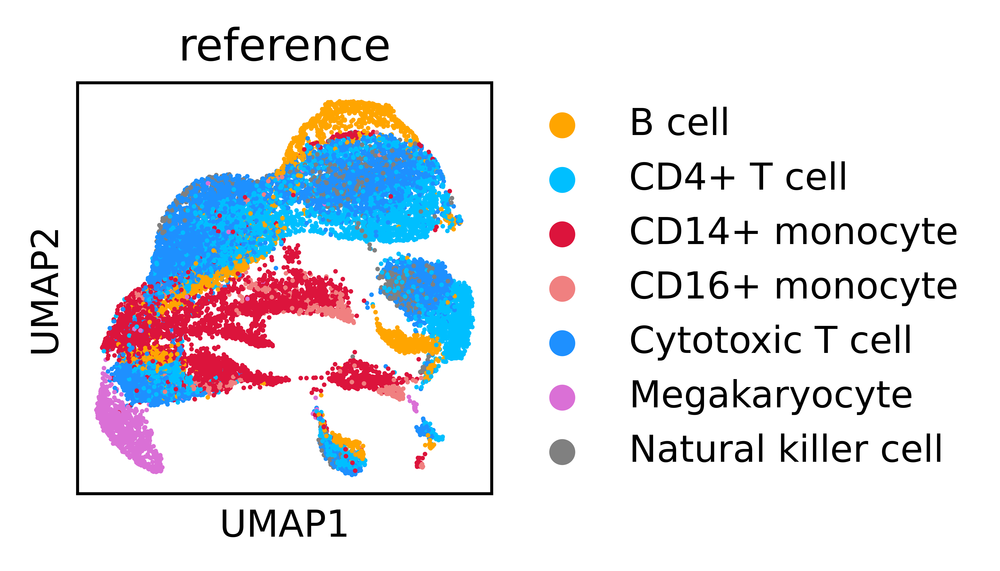

In [5]:
sc.pp.neighbors(ref)
sc.tl.umap(ref)

# rename labels for the plots 
ref.obs['reference'] = ref.obs['labels'].astype('str')

with plt.rc_context({'figure.figsize': (2, 2), 'figure.dpi': (1500)}):
    sc.pl.umap(ref, color='reference', palette=palette)


We can retrieve the underlying hvg embedding performed before the OT step as follows:

In [13]:

hvg = HVGEmbedder(max_cluster_size=None)
hvg.fit(q, ref)

q_embed = hvg.embed(q)
ref_embed = hvg.embed(ref)

[embeddings      ] [DEBUG   ] : Using 1254 genes.


In [16]:
# create a new anndata object for joint umap
X = np.concatenate((q_embed, ref_embed), axis=0)
obs = pd.concat((q.obs['query'], ref.obs['reference']), axis=0)
obs = obs.to_frame(name='labels')

ad = sc.AnnData(X, obs)

/opt/homebrew/anaconda3/envs/refcm/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning:

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.



         Falling back to preprocessing with `sc.pp.pca` and default params.


/opt/homebrew/anaconda3/envs/refcm/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning:

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.

/opt/homebrew/anaconda3/envs/refcm/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning:

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.

... storing 'labels' as categorical
... storing 'query' as categorical
... storing 'reference' as categorical


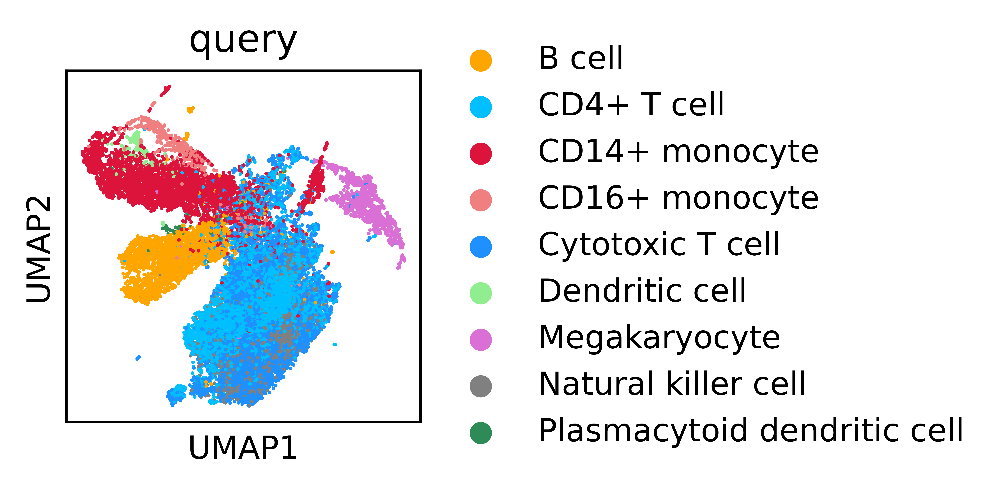

... storing 'labels' as categorical
... storing 'query' as categorical
... storing 'reference' as categorical


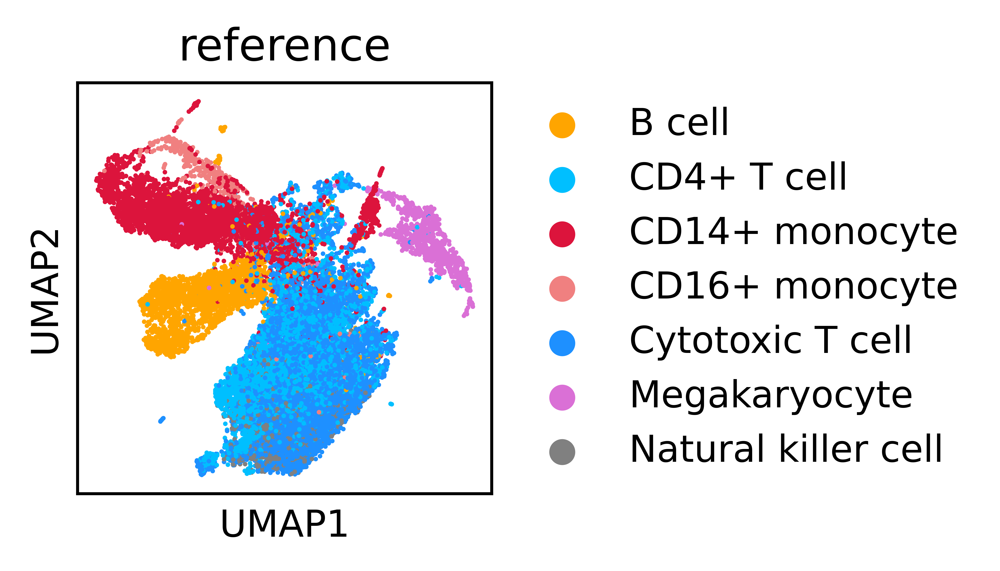

In [17]:
sc.pp.neighbors(ad)
sc.tl.umap(ad)

# rename labels for the plots
ad.obs['query'] = ad.obs['labels'].astype('str')
ad.obs['reference'] = ad.obs['labels'].astype('str')

q_embed = ad[:q_embed.shape[0]].copy()
ref_embed = ad[q_embed.shape[0]:].copy()

with plt.rc_context({'figure.figsize': (2, 2), 'figure.dpi': (1500)}):
    sc.pl.umap(q_embed, color='query', palette=palette)
    sc.pl.umap(ref_embed, color='reference', palette=palette)


In [23]:
q_embed.obs

,labels,query,reference
pbmc1_Drop_AAAAGATGTGGT,CD4+ T cell,CD4+ T cell,CD4+ T cell
pbmc1_Drop_AAAAGGATTTCC,Cytotoxic T cell,Cytotoxic T cell,Cytotoxic T cell
pbmc1_Drop_AAAAGTGTTTAA,Cytotoxic T cell,Cytotoxic T cell,Cytotoxic T cell
pbmc1_Drop_AAAATGATGTAT,Cytotoxic T cell,Cytotoxic T cell,Cytotoxic T cell
pbmc1_Drop_AAACAAACCGAC,Natural killer cell,Natural killer cell,Natural killer cell
...,...,...,...
pbmc2_Drop_CAGGCAGCACTC,Cytotoxic T cell,Cytotoxic T cell,Cytotoxic T cell
pbmc2_Drop_CAGGCCTGCCCA,B cell,B cell,B cell
pbmc2_Drop_CGATCCTACATA,Natural killer cell,Natural killer cell,Natural killer cell
pbmc2_Drop_CGCGATCACGTG,Natural killer cell,Natural killer cell,Natural killer cell


/opt/homebrew/anaconda3/envs/refcm/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning:

Trying to modify attribute `._uns` of view, initializing view as actual.



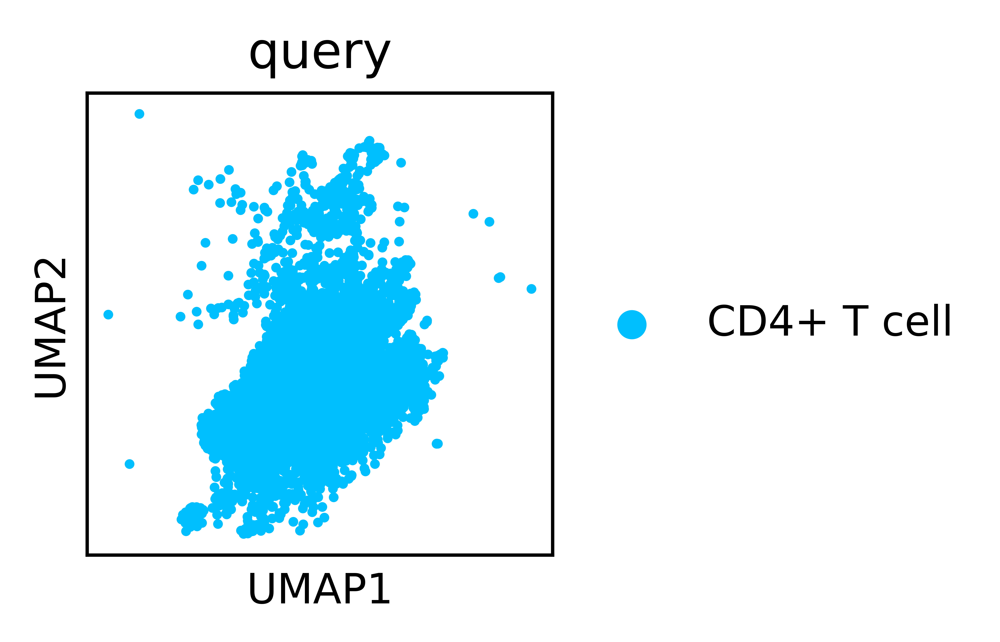

/opt/homebrew/anaconda3/envs/refcm/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning:

Trying to modify attribute `._uns` of view, initializing view as actual.



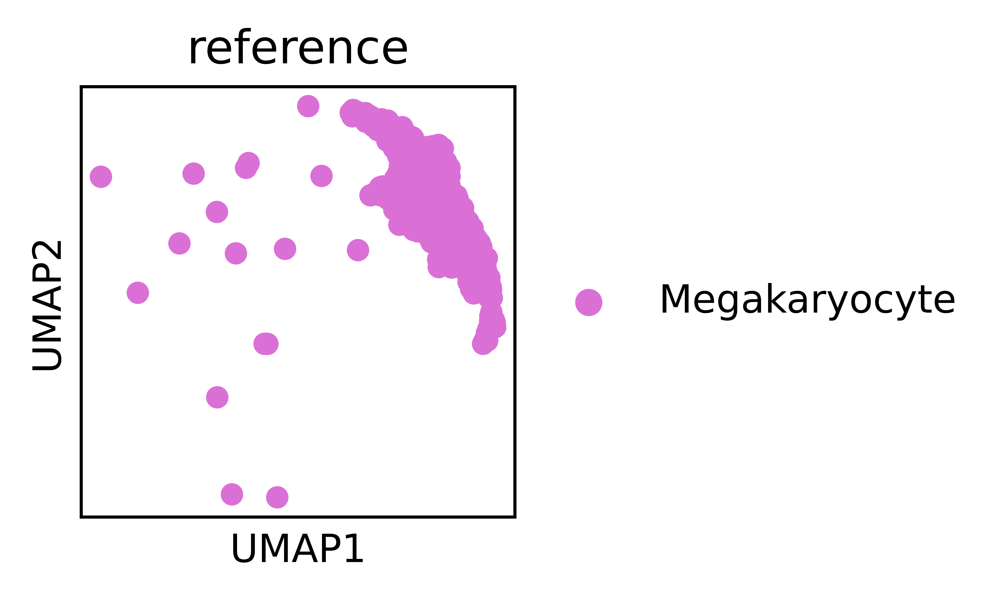

In [26]:
# q = q[q.obs['labels'] == 'B cell']
# ref = ref[ref.obs['labels'] == 'CD4+ T cell']


with plt.rc_context({'figure.figsize': (2, 2), 'figure.dpi': (1500)}):
    sc.pl.umap(q_embed[q_embed.obs['query'] == 'CD4+ T cell'], color='query', palette=palette)
    sc.pl.umap(ref_embed[ref_embed.obs['reference'] == 'Megakaryocyte'], color='reference', palette=palette)

In [18]:
for i in q.obs['labels'].unique():
    print(f"{i}: {(q.obs['labels'] == i).sum()}")

CD4+ T cell: 5551
Cytotoxic T cell: 7517
Natural killer cell: 1117
CD14+ monocyte: 3922
CD16+ monocyte: 608
B cell: 3224
Dendritic cell: 209
Megakaryocyte: 904
Plasmacytoid dendritic cell: 102


In [19]:
for i in ref.obs['labels'].unique():
    print(f"{i}: {(q.obs['labels'] == i).sum()}")

CD4+ T cell: 5551
Cytotoxic T cell: 7517
Natural killer cell: 1117
CD16+ monocyte: 608
CD14+ monocyte: 3922
Megakaryocyte: 904
B cell: 3224


In [16]:

dists = pairwise_distances(q[q.obs['labels'] == 'CD16+ monocyte'].X, ref[ref.obs['labels'] == 'Megakaryocyte'].X)

/opt/homebrew/anaconda3/envs/refcm/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning:

Trying to modify attribute `._uns` of view, initializing view as actual.



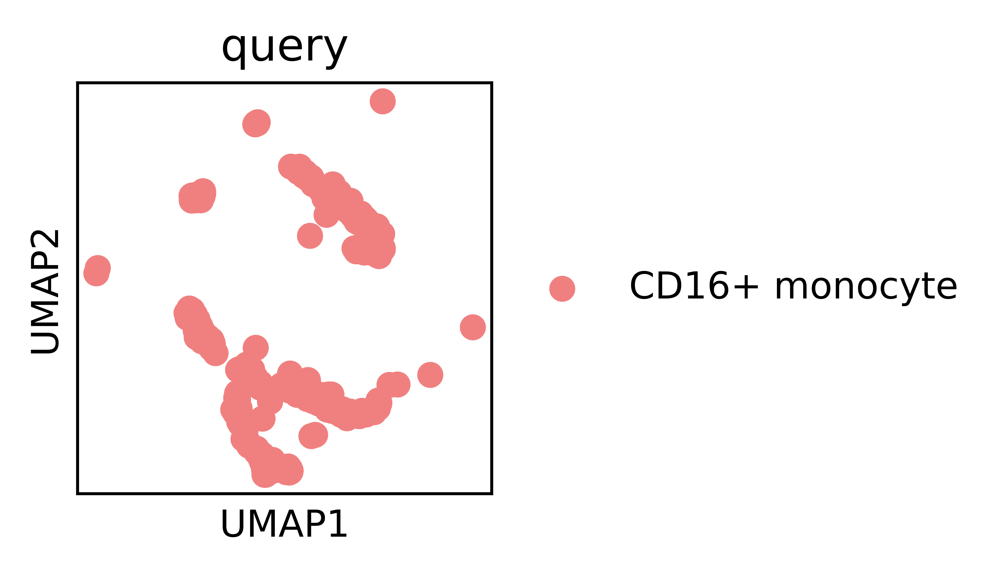

/opt/homebrew/anaconda3/envs/refcm/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning:

Trying to modify attribute `._uns` of view, initializing view as actual.



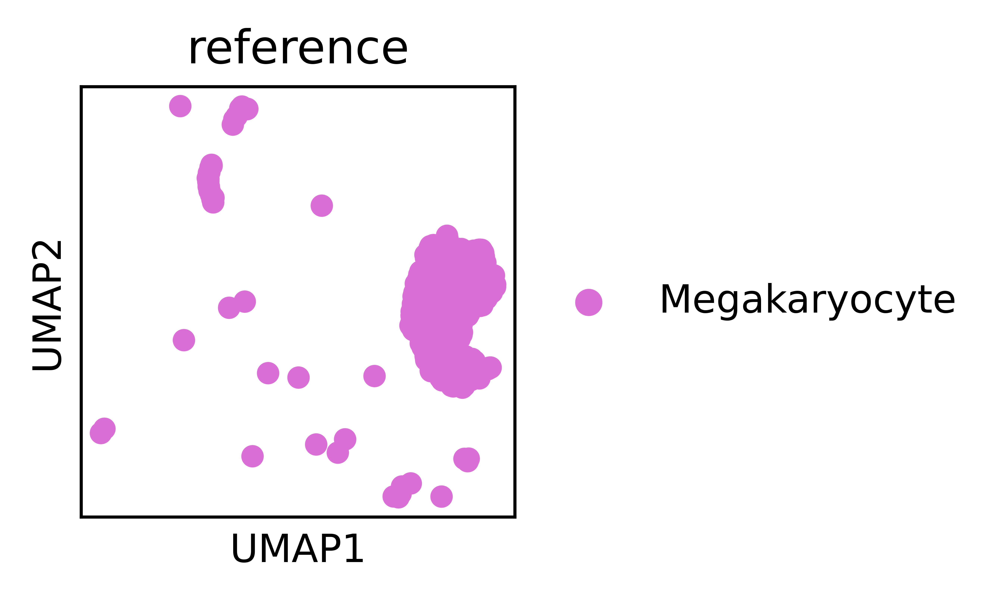

In [19]:
q = q[q.obs['labels'] == 'CD16+ monocyte']
ref = ref[ref.obs['labels'] == 'Megakaryocyte']


with plt.rc_context({'figure.figsize': (2, 2), 'figure.dpi': (1500)}):
    sc.pl.umap(q, color='query', palette=palette)
    sc.pl.umap(ref, color='reference', palette=palette)

In [18]:

px.imshow(dists, width=700)